<a href="https://colab.research.google.com/github/stwind/gan-experiments/blob/master/notebooks/wgan_specnorm_flower102_ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -Uq git+https://github.com/stwind/gan-experiments.git

## Setup

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import io
import os
import h5py
import shutil

import numpy as np
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import PIL
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.datasets as dset
import torchvision.transforms as tfms
from torch.utils.data import DataLoader, Dataset, ConcatDataset
from torchvision.utils import make_grid
from torchinfo import summary
from fastprogress.fastprogress import progress_bar
from matplotlib.gridspec import GridSpec
from multiprocessing import Manager

import ganexp.utils as utils
import ganexp.functional as gF
from ganexp.plots.hinton import hinton
from ganexp.nn import SSIM

sns.set('notebook', 'darkgrid', rc={
    'font.family': ['DejaVu Sans'],
    'font.sans-serif': ['Open Sans', 'Arial Unicode MS'],
    'font.size': 12,
    'figure.figsize': (8, 5),
    'grid.linewidth': 1,
    'grid.alpha': 0.5,
    'legend.fontsize': 10,
    'legend.frameon': True,
    'legend.framealpha': 0.6,
    'legend.handletextpad': 0.2,
    'lines.linewidth': 1,
    'axes.facecolor': '#fafafa',
    'axes.labelsize': 11,
    'axes.titlesize': 12,
    'axes.linewidth': 0.5,
    'xtick.labelsize': 11,
    'xtick.major.width': 0.5,
    'ytick.labelsize': 11,
    'ytick.major.width': 0.5,
    'figure.titlesize': 13,
})
plt.style.use("dark_background")

print("Infos:")
print("numpy: {}".format(np.__version__))
print("seaborn: {}".format(sns.__version__))
print("matplotlib: {}".format(mpl.__version__))
print("pytorch: {}".format(torch.__version__))
for i in range(torch.cuda.device_count()):
    print("cuda device #{}: {}".format(i, torch.cuda.get_device_name(i)))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("current device type: {}".format(device.type))

Infos:
numpy: 1.19.5
seaborn: 0.11.1
matplotlib: 3.2.2
pytorch: 1.7.0+cu101
cuda device #0: Tesla K80
current device type: cuda


## Data

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [4]:
url = "https://www.robots.ox.ac.uk/~vgg/data/flowers/102/102flowers.tgz"
dataroot = '/content/gdrive/MyDrive/flowers102'

# dset.utils.download_and_extract_archive(url, dataroot)

# with h5py.File(os.path.join(dataroot, "flowers102.hdf5"), 'a') as hf:
#     grp = hf.create_group("images")
#     for p in progress_bar(os.listdir(os.path.join(dataroot, "jpg"))):
#         img_path = os.path.join(dataroot, "jpg", p)
#         with open(img_path, 'rb') as f:
#             data = f.read()
#         dset = grp.create_dataset(p, data=np.asarray(data))

shutil.copyfile(os.path.join(dataroot, "flowers102.hdf5"), "/content/sample_data/flowers102.hdf5")
datafile = "/content/sample_data/flowers102.hdf5"

In [5]:
class HDF5ImageDataset(Dataset):
    def __init__(self, file_path, transform=None):
        super().__init__()
        self.data_info = []
        self.cache = []
        self.transform = transform
        self._add_data_infos(file_path)
        
    def _add_data_infos(self, file_path):
        with h5py.File(file_path, "r") as hf:
            for _, group in hf.items():
                for name, obj in group.items():
                    idx = self._add_to_cache(obj)
                    self.data_info.append({"index": idx})
                    
    def _add_to_cache(self, obj):
        self.cache.append(obj[()])
        return len(self.cache) - 1
    
    def get_data(self, idx):
        info = self.data_info[idx]
        obj = self.cache[info["index"]]
        data = np.array(obj)
        img = PIL.Image.open(io.BytesIO(data))
        return img

    def __getitem__(self, index):
        x = self.get_data(index)
        if self.transform:
            x = self.transform(x)
        return x, index

    def __len__(self):
        return len(self.data_info)


image_size = 256
batch_size = 64
workers = 16
pin_memory = device.type == 'cuda'

MEAN = np.array([0.5, 0.5, 0.5])
STD = np.array([0.5, 0.5, 0.5])

normalize = tfms.Normalize(MEAN, STD)
denormalize = tfms.Normalize(-MEAN / STD, 1 / STD)

dataset = HDF5ImageDataset(datafile,
                           transform=tfms.Compose([tfms.Resize(image_size),
                                                   tfms.CenterCrop(image_size),
                                                   tfms.ToTensor(),
                                                   normalize]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers,
                                         pin_memory=pin_memory)

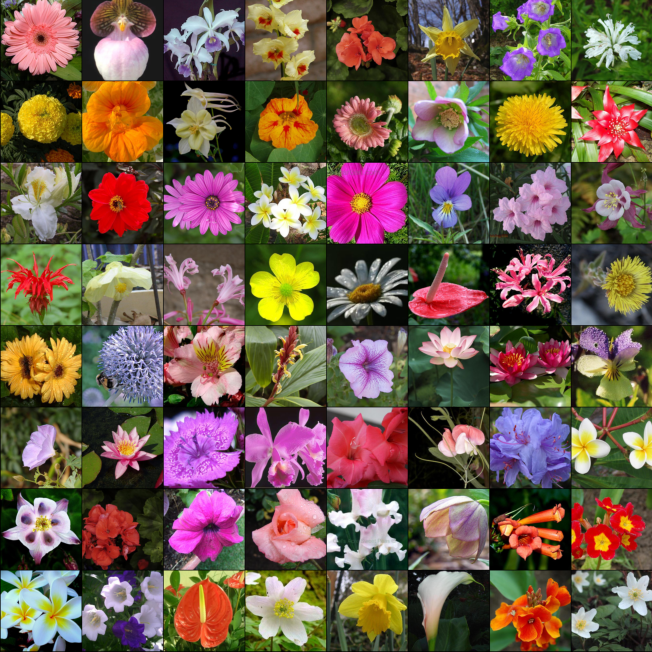

In [6]:
batch, indices = next(iter(dataloader))

fig, ax = plt.subplots(figsize=(6,6))

ax.imshow(make_grid(denormalize(batch[:64]), nrow=8, padding=2).permute(1,2,0).numpy())
ax.set_axis_off()

with plt.rc_context({"savefig.pad_inches": 0}):
    plt.show()

## Model

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight, 1.0, 0.02)
        nn.init.zeros_(m.bias)

class Generator(nn.Module):
    def __init__(self, num_embeddings, nz, nc=3):
        super().__init__()
        self.embedding = nn.Embedding(num_embeddings, nz)
        self.net = nn.Sequential(
            nn.ConvTranspose2d(nz, 256, 4, 1, 0),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 32, 4, 2, 1),
            nn.BatchNorm2d(32),
            nn.ReLU(True),

            nn.ConvTranspose2d(32, 16, 4, 2, 1),
            nn.BatchNorm2d(16),
            nn.ReLU(True),

            nn.ConvTranspose2d(16, 8, 4, 2, 1),
            nn.BatchNorm2d(8),
            nn.ReLU(True),

            nn.ConvTranspose2d(8, nc, 4, 2, 1),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.embedding(x)
        x = x.unsqueeze(2).unsqueeze(3)
        return self.net(x)


class Discriminator(nn.Module):
    def __init__(self, nc):
        super().__init__()
        self.net = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(nc, 8, 4, 2, 1)),
            nn.LeakyReLU(0.1, True),

            nn.utils.spectral_norm(nn.Conv2d(8, 16, 4, 2, 1)),
            nn.LeakyReLU(0.1, True),

            nn.utils.spectral_norm(nn.Conv2d(16, 32, 4, 2, 1)),
            nn.LeakyReLU(0.1, True),

            nn.utils.spectral_norm(nn.Conv2d(32, 64, 4, 2, 1)),
            nn.LeakyReLU(0.1, True),

            nn.utils.spectral_norm(nn.Conv2d(64, 128, 4, 2, 1)),
            nn.LeakyReLU(0.1, True),

            nn.utils.spectral_norm(nn.Conv2d(128, 256, 4, 2, 1)),
            nn.LeakyReLU(0.1, True),

            nn.utils.spectral_norm(nn.Conv2d(256, 1, 4, 1, 0)),
        )

    def forward(self, x):
        x = self.net(x)
        return x.squeeze()
    
nz = 128
nc = 3
save_path = "/content/gdrive/MyDrive/cleaner3_emb_specnorm_ttur_RaLSGAN_flower_256"
os.makedirs(save_path, exist_ok=True)

print("Generator")
netG = Generator(len(dataset), nz, nc).to(device)
netG.apply(weights_init)
netG.load_state_dict(torch.load('{}/G_{:03d}_loss_{:.4f}.pt'.format(save_path, 1399, 2.7166), map_location=device))
summary(netG, (1,), dtypes=[torch.int64])

print("Discriminator")
netD = Discriminator(nc).to(device)
netD.apply(weights_init)
netD.load_state_dict(torch.load('{}/D_{:03d}_loss_{:.4f}.pt'.format(save_path, 1399, 0.4908), map_location=device))
summary(netD, (1,nc,image_size,image_size), verbose=False)

Generator
Layer (type:depth-idx)                   Output Shape              Param #
├─Embedding: 1-1                         [1, 128]                  1,048,192
├─Sequential: 1-2                        [1, 3, 256, 256]          --
|    └─ConvTranspose2d: 2-1              [1, 256, 4, 4]            524,544
|    └─BatchNorm2d: 2-2                  [1, 256, 4, 4]            512
|    └─ReLU: 2-3                         [1, 256, 4, 4]            --
|    └─ConvTranspose2d: 2-4              [1, 128, 8, 8]            524,416
|    └─BatchNorm2d: 2-5                  [1, 128, 8, 8]            256
|    └─ReLU: 2-6                         [1, 128, 8, 8]            --
|    └─ConvTranspose2d: 2-7              [1, 64, 16, 16]           131,136
|    └─BatchNorm2d: 2-8                  [1, 64, 16, 16]           128
|    └─ReLU: 2-9                         [1, 64, 16, 16]           --
|    └─ConvTranspose2d: 2-10             [1, 32, 32, 32]           32,800
|    └─BatchNorm2d: 2-11                 [1, 3

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [1, 1, 1, 1]              --
|    └─Conv2d: 2-1                       [1, 8, 128, 128]          392
|    └─LeakyReLU: 2-2                    [1, 8, 128, 128]          --
|    └─Conv2d: 2-3                       [1, 16, 64, 64]           2,064
|    └─LeakyReLU: 2-4                    [1, 16, 64, 64]           --
|    └─Conv2d: 2-5                       [1, 32, 32, 32]           8,224
|    └─LeakyReLU: 2-6                    [1, 32, 32, 32]           --
|    └─Conv2d: 2-7                       [1, 64, 16, 16]           32,832
|    └─LeakyReLU: 2-8                    [1, 64, 16, 16]           --
|    └─Conv2d: 2-9                       [1, 128, 8, 8]            131,200
|    └─LeakyReLU: 2-10                   [1, 128, 8, 8]            --
|    └─Conv2d: 2-11                      [1, 256, 4, 4]            524,544
|    └─LeakyReLU: 2-12                   [1, 256, 4, 4]         

## Training

In [ ]:
batch, indices = next(iter(dataloader))
fix_z = indices.to(device)

ssim_loss = SSIM(nc)

optimizerD = torch.optim.Adam(netD.parameters(), lr=4e-4, betas=(0.5, 0.99))
optimizerG = torch.optim.Adam(netG.parameters(), lr=1e-4, betas=(0.5, 0.99))

In [ ]:
epoch_start, epoch_end = 1300, 1400
snap_every = 10
save_every = 10

G_losses = []
D_losses = []
crit_reals = []
crit_fakes = []
fix_results = []

for epoch in progress_bar(range(epoch_start, epoch_end)):
    for i, (data, indices) in enumerate(progress_bar(dataloader, leave=False)):
        data = data.to(device)
        z = indices.to(device)

        ## train discriminator
        generated_data = netG(z)
        crit_fake = netD(generated_data)
        crit_real = netD(data)

        d_ssim = ssim_loss(data, generated_data)
        d_loss = (torch.mean((crit_real - torch.mean(crit_fake) - 1.0) ** 2) + torch.mean((crit_fake - torch.mean(crit_real) + 1.0) ** 2))/2 + d_ssim

        optimizerD.zero_grad()
        d_loss.backward()
        optimizerD.step()

        ## train generator
        generated_data = netG(z)
        crit_fake = netD(generated_data)
        crit_real = netD(data)

        g_ssim = ssim_loss(data, generated_data)
        g_loss = (torch.mean((crit_real - torch.mean(crit_fake) + 1.0) ** 2) + torch.mean((crit_fake - torch.mean(crit_real) - 1.0) ** 2))/2 - g_ssim

        optimizerG.zero_grad()
        g_loss.backward()
        optimizerG.step()

        ## collect stats
        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())
        crit_reals.append(crit_real.mean().item())
        crit_fakes.append(crit_fake.mean().item())
        
    print('[{:>2}/{:>2}] D_loss: {:.3f} G_loss: {:.3f} CR: {:.3f} CF: {:.3f}'.format(
        epoch, epoch_end,
        d_loss, g_loss, crit_real.mean(), crit_fake.mean()))

    if epoch % snap_every == 0:
        with torch.no_grad():
            fake = netG(fix_z).cpu()
            fix_results.append(fake)
    
    if epoch % save_every == 0 or epoch == epoch_end - 1:
        torch.save(netD.state_dict(), '{}/D_{:03d}_loss_{:.4f}.pt'.format(save_path, epoch, D_losses[-1]))
        torch.save(netG.state_dict(), '{}/G_{:03d}_loss_{:.4f}.pt'.format(save_path, epoch, G_losses[-1]))

[1300/1400] D_loss: 0.296 G_loss: 3.479 CR: -0.400 CF: -1.244


[1301/1400] D_loss: 0.263 G_loss: 3.296 CR: -0.964 CF: -1.776


[1302/1400] D_loss: 0.336 G_loss: 3.388 CR: -0.332 CF: -1.165


[1303/1400] D_loss: 0.333 G_loss: 2.928 CR: -0.208 CF: -0.902


[1304/1400] D_loss: 0.283 G_loss: 3.394 CR: -0.734 CF: -1.574


[1305/1400] D_loss: 0.281 G_loss: 3.770 CR: -1.253 CF: -2.177


[1306/1400] D_loss: 0.295 G_loss: 3.472 CR: -1.321 CF: -2.157


[1307/1400] D_loss: 0.353 G_loss: 3.302 CR: 0.126 CF: -0.683


[1308/1400] D_loss: 0.350 G_loss: 3.181 CR: -0.247 CF: -1.014


[1309/1400] D_loss: 0.345 G_loss: 3.152 CR: -0.449 CF: -1.208


[1310/1400] D_loss: 0.345 G_loss: 3.156 CR: -0.901 CF: -1.656


[1311/1400] D_loss: 0.266 G_loss: 3.267 CR: -0.869 CF: -1.659


[1312/1400] D_loss: 0.272 G_loss: 3.203 CR: -0.464 CF: -1.238


[1313/1400] D_loss: 0.300 G_loss: 3.184 CR: -0.751 CF: -1.517


[1314/1400] D_loss: 0.327 G_loss: 3.457 CR: -0.756 CF: -1.595


[1315/1400] D_loss: 0.188 G_loss: 3.407 CR: -1.288 CF: -2.131


[1316/1400] D_loss: 0.490 G_loss: 3.119 CR: -0.975 CF: -1.732


[1317/1400] D_loss: 0.492 G_loss: 3.180 CR: -0.584 CF: -1.355


[1318/1400] D_loss: 0.383 G_loss: 3.130 CR: -0.633 CF: -1.395


[1319/1400] D_loss: 0.453 G_loss: 3.073 CR: -1.212 CF: -1.952


[1320/1400] D_loss: 0.682 G_loss: 3.657 CR: 0.748 CF: -0.132


[1321/1400] D_loss: 0.395 G_loss: 2.980 CR: -0.660 CF: -1.358


[1322/1400] D_loss: 0.352 G_loss: 3.203 CR: -0.064 CF: -0.845


[1323/1400] D_loss: 0.297 G_loss: 3.462 CR: -1.913 CF: -2.754


[1324/1400] D_loss: 0.237 G_loss: 3.554 CR: -0.030 CF: -0.906


[1325/1400] D_loss: 0.375 G_loss: 3.216 CR: 0.402 CF: -0.359


[1326/1400] D_loss: 0.346 G_loss: 3.598 CR: -0.280 CF: -1.161


[1327/1400] D_loss: 0.328 G_loss: 3.237 CR: -0.992 CF: -1.782


[1328/1400] D_loss: 0.465 G_loss: 3.009 CR: -1.080 CF: -1.802


[1329/1400] D_loss: 0.329 G_loss: 3.200 CR: -0.892 CF: -1.663


[1330/1400] D_loss: 0.263 G_loss: 3.593 CR: -0.662 CF: -1.539


[1331/1400] D_loss: 0.229 G_loss: 3.216 CR: -0.545 CF: -1.333


[1332/1400] D_loss: 0.265 G_loss: 3.281 CR: -0.495 CF: -1.298


[1333/1400] D_loss: 0.271 G_loss: 3.165 CR: -1.721 CF: -2.492


[1334/1400] D_loss: 0.194 G_loss: 3.517 CR: -0.809 CF: -1.671


[1335/1400] D_loss: 0.299 G_loss: 2.930 CR: -1.215 CF: -1.918


[1336/1400] D_loss: 0.378 G_loss: 3.268 CR: -0.441 CF: -1.235


[1337/1400] D_loss: 0.367 G_loss: 3.255 CR: -0.342 CF: -1.126


[1338/1400] D_loss: 0.327 G_loss: 3.383 CR: -1.107 CF: -1.925


[1339/1400] D_loss: 0.228 G_loss: 3.636 CR: -0.776 CF: -1.674


[1340/1400] D_loss: 0.363 G_loss: 3.158 CR: -1.348 CF: -2.105


[1341/1400] D_loss: 0.347 G_loss: 2.836 CR: -0.598 CF: -1.269


[1342/1400] D_loss: 0.272 G_loss: 3.227 CR: -0.540 CF: -1.323


[1343/1400] D_loss: 0.319 G_loss: 3.456 CR: -0.377 CF: -1.220


[1344/1400] D_loss: 0.554 G_loss: 2.719 CR: -0.744 CF: -1.387


[1345/1400] D_loss: 0.357 G_loss: 3.059 CR: -0.935 CF: -1.680


[1346/1400] D_loss: 0.303 G_loss: 3.207 CR: 0.107 CF: -0.671


[1347/1400] D_loss: 0.299 G_loss: 3.135 CR: -0.906 CF: -1.674


[1348/1400] D_loss: 0.226 G_loss: 3.440 CR: -0.592 CF: -1.443


[1349/1400] D_loss: 0.310 G_loss: 3.438 CR: -0.607 CF: -1.434


[1350/1400] D_loss: 0.434 G_loss: 3.186 CR: 0.191 CF: -0.562


[1351/1400] D_loss: 0.263 G_loss: 3.675 CR: -0.312 CF: -1.211


[1352/1400] D_loss: 0.353 G_loss: 3.345 CR: -0.561 CF: -1.376


[1353/1400] D_loss: 0.408 G_loss: 3.201 CR: -0.985 CF: -1.755


[1354/1400] D_loss: 0.208 G_loss: 3.487 CR: -0.522 CF: -1.381


[1355/1400] D_loss: 0.312 G_loss: 3.371 CR: 0.520 CF: -0.300


[1356/1400] D_loss: 0.489 G_loss: 2.749 CR: -1.424 CF: -2.070


[1357/1400] D_loss: 0.318 G_loss: 3.172 CR: -1.056 CF: -1.836


[1358/1400] D_loss: 0.316 G_loss: 3.671 CR: 0.637 CF: -0.244


[1359/1400] D_loss: 0.351 G_loss: 3.001 CR: -0.212 CF: -0.933


[1360/1400] D_loss: 0.300 G_loss: 3.342 CR: -1.506 CF: -2.317


[1361/1400] D_loss: 0.198 G_loss: 3.797 CR: -0.665 CF: -1.597


[1362/1400] D_loss: 0.297 G_loss: 3.917 CR: -0.284 CF: -1.256


[1363/1400] D_loss: 0.358 G_loss: 3.071 CR: -0.169 CF: -0.916


[1364/1400] D_loss: 0.389 G_loss: 3.346 CR: -0.328 CF: -1.142


[1365/1400] D_loss: 0.264 G_loss: 3.516 CR: 0.007 CF: -0.856


[1366/1400] D_loss: 0.423 G_loss: 3.144 CR: 0.724 CF: -0.022


[1367/1400] D_loss: 0.262 G_loss: 3.375 CR: -0.741 CF: -1.566


[1368/1400] D_loss: 0.462 G_loss: 3.145 CR: -0.408 CF: -1.157


[1369/1400] D_loss: 0.345 G_loss: 3.170 CR: -0.943 CF: -1.706


[1370/1400] D_loss: 0.376 G_loss: 3.107 CR: -0.654 CF: -1.411


[1371/1400] D_loss: 0.336 G_loss: 3.024 CR: -0.840 CF: -1.573


[1372/1400] D_loss: 0.394 G_loss: 3.121 CR: -1.115 CF: -1.874


[1373/1400] D_loss: 0.203 G_loss: 3.640 CR: -0.618 CF: -1.514


[1374/1400] D_loss: 0.265 G_loss: 3.386 CR: -1.436 CF: -2.265


[1375/1400] D_loss: 0.329 G_loss: 3.068 CR: -1.592 CF: -2.332


[1376/1400] D_loss: 0.226 G_loss: 3.450 CR: 0.038 CF: -0.810


[1377/1400] D_loss: 0.363 G_loss: 3.539 CR: -1.028 CF: -1.895


[1378/1400] D_loss: 0.230 G_loss: 3.424 CR: -0.767 CF: -1.614


[1379/1400] D_loss: 0.305 G_loss: 3.277 CR: -0.092 CF: -0.887


[1380/1400] D_loss: 0.270 G_loss: 3.200 CR: 0.084 CF: -0.694


[1381/1400] D_loss: 0.217 G_loss: 3.511 CR: -0.755 CF: -1.623


[1382/1400] D_loss: 0.410 G_loss: 3.308 CR: -0.528 CF: -1.335


[1383/1400] D_loss: 0.341 G_loss: 2.815 CR: -0.657 CF: -1.329


[1384/1400] D_loss: 0.368 G_loss: 3.243 CR: 0.076 CF: -0.701


[1385/1400] D_loss: 0.394 G_loss: 3.270 CR: -0.358 CF: -1.156


[1386/1400] D_loss: 0.305 G_loss: 3.273 CR: 0.319 CF: -0.476


[1387/1400] D_loss: 0.428 G_loss: 3.075 CR: -0.595 CF: -1.342


[1388/1400] D_loss: 0.405 G_loss: 3.582 CR: 0.779 CF: -0.077


[1389/1400] D_loss: 0.399 G_loss: 3.345 CR: -1.565 CF: -2.378


[1390/1400] D_loss: 0.403 G_loss: 3.010 CR: -0.421 CF: -1.149


[1391/1400] D_loss: 0.379 G_loss: 3.215 CR: -0.161 CF: -0.948


[1392/1400] D_loss: 0.286 G_loss: 3.554 CR: -0.996 CF: -1.869


[1393/1400] D_loss: 0.431 G_loss: 3.058 CR: -0.521 CF: -1.261


[1394/1400] D_loss: 0.299 G_loss: 3.631 CR: 0.464 CF: -0.427


[1395/1400] D_loss: 0.355 G_loss: 3.272 CR: -0.149 CF: -0.951


[1396/1400] D_loss: 0.307 G_loss: 3.228 CR: -0.738 CF: -1.522


[1397/1400] D_loss: 0.359 G_loss: 3.300 CR: -0.695 CF: -1.495


[1398/1400] D_loss: 0.306 G_loss: 3.598 CR: -1.525 CF: -2.400


[1399/1400] D_loss: 0.491 G_loss: 2.717 CR: -0.626 CF: -1.261


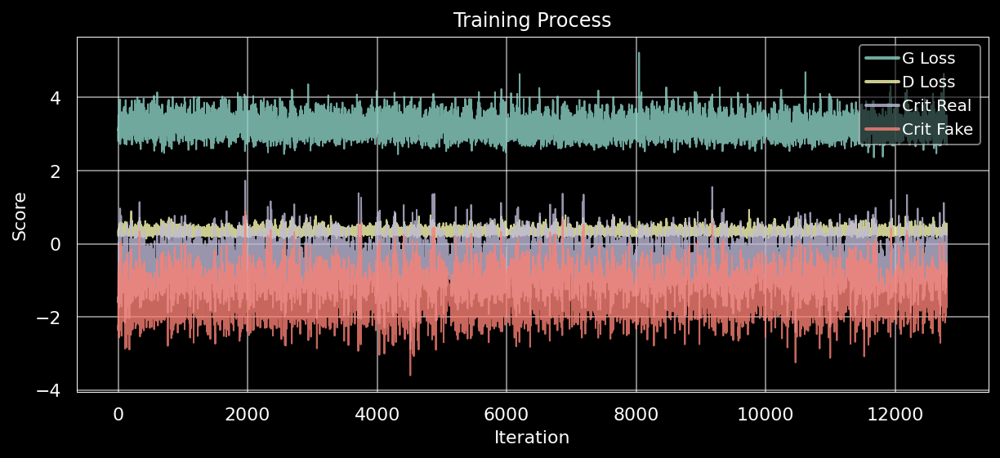

In [ ]:
fig, ax = plt.subplots(figsize=(10,4))

ax.plot(G_losses, label="G Loss", alpha=0.8)
ax.plot(D_losses, label="D Loss", alpha=0.8)
ax.plot(crit_reals, label="Crit Real", alpha=0.8)
ax.plot(crit_fakes, label="Crit Fake", alpha=0.8)
ax.set(xlabel="Iteration", ylabel="Score", title="Training Process")
leg = ax.legend(loc="upper right")
for line in leg.get_lines():
    line.set_linewidth(2.0)

plt.show()

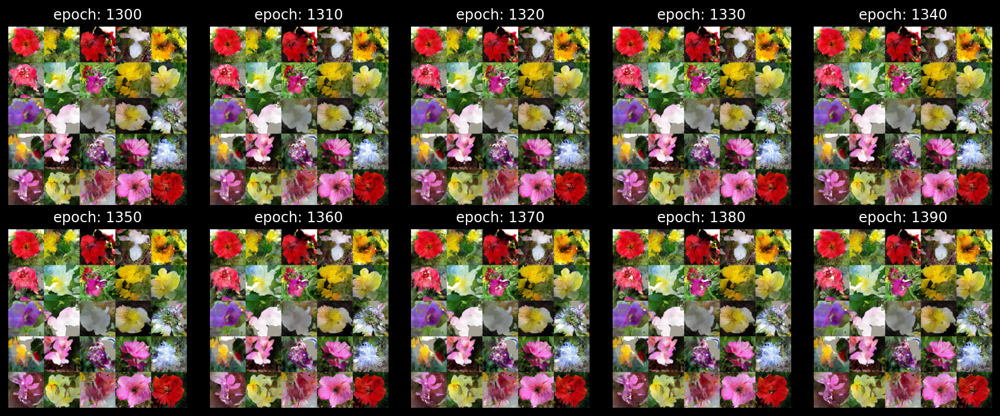

In [ ]:
ncol = min(len(fix_results), 5)
nrow = len(fix_results) // ncol

fig = plt.figure(figsize=(12, nrow * 2.5))

for i, img in enumerate(fix_results):
    ax = fig.add_subplot(nrow, ncol, i + 1)
    ax.imshow(make_grid(denormalize(img[:25]),nrow=5,padding=0).permute(1,2,0).numpy())
    ax.set_axis_off()
    ax.set_title("epoch: {}".format(epoch_start + i * snap_every),fontsize="medium")

plt.tight_layout()
plt.show()

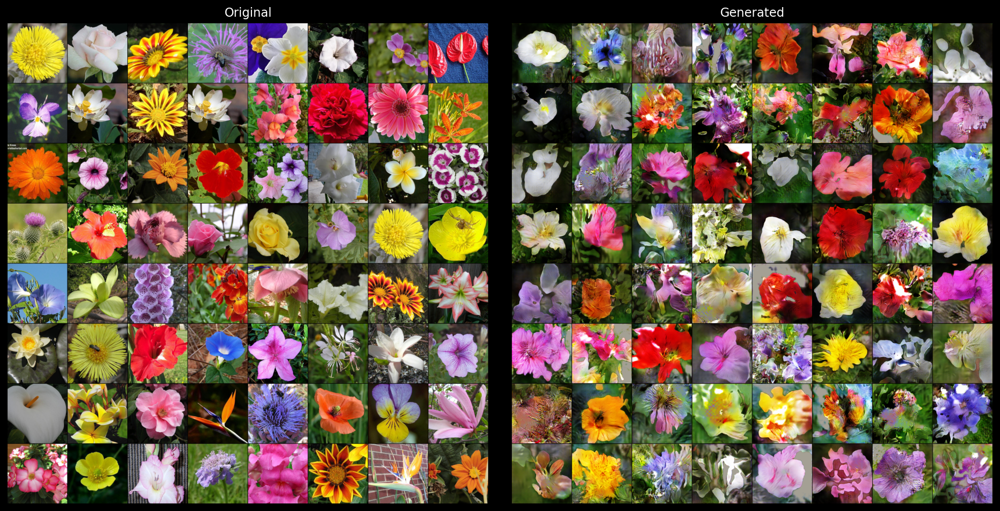

In [ ]:
batch, indices = next(iter(dataloader))

recon = netG(indices.to(device)).detach().cpu()

fig, ax = plt.subplots(1, 2, figsize=(14,7))

ax[0].imshow(make_grid(denormalize(batch),nrow=8,padding=2).permute(1,2,0).numpy())
ax[0].set_axis_off()
ax[0].set_title("Original", fontsize="medium")

ax[1].imshow(make_grid(denormalize(recon),nrow=8,padding=2).permute(1,2,0).numpy())
ax[1].set_axis_off()
ax[1].set_title("Generated", fontsize="medium")

plt.tight_layout()
plt.show()

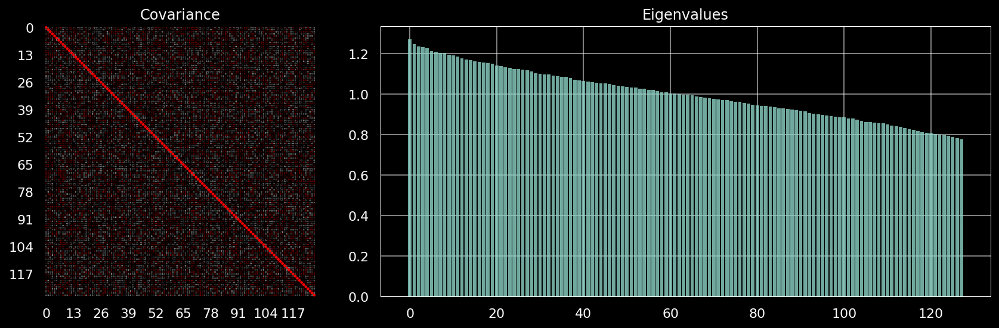

In [ ]:
x_enc = netG.embedding.weight.detach().cpu()
x_mean, x_std = x_enc.mean(0), x_enc.std(0)
x_cov = gF.cov((x_enc - x_mean).t())
evals_comp, evecs = x_cov.eig(eigenvectors=True)
evals = evals_comp[:,0]

fig = plt.figure(figsize=(12,4))
gs = GridSpec(1, 2, width_ratios=[3,6])

ax = fig.add_subplot(gs[0,0])
hinton(x_cov.numpy(), ax=ax)
ax.set_title("Covariance")

ax = fig.add_subplot(gs[0,1])
ax.bar(np.arange(evals.shape[0]), evals.sort(descending=True)[0], alpha=0.8, lw=0)
ax.set_title("Eigenvalues")

plt.tight_layout()
plt.show()

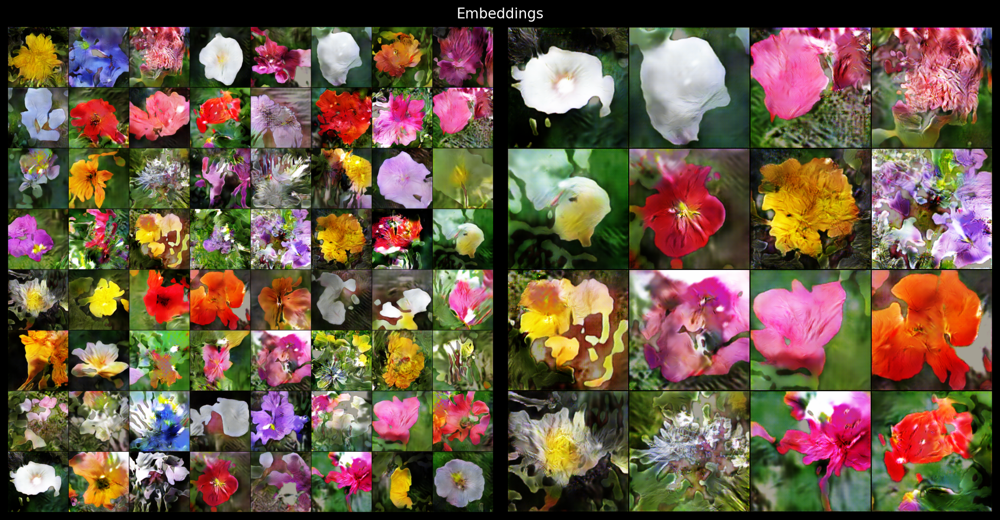

In [ ]:
indices = torch.randint(0,len(dataset),(64,)).to(device)
imgs = netG(indices).detach().cpu()

fig = plt.figure(figsize=(13,7))

ax = fig.add_subplot(1, 2, 1)
ax.imshow(make_grid(denormalize(imgs),nrow=8,padding=2).permute(1,2,0).numpy())
ax.set_axis_off()

ax = fig.add_subplot(1, 2, 2)
ax.imshow(make_grid(denormalize(imgs[torch.randperm(64)[:16]]),nrow=4,padding=2).permute(1,2,0).numpy())
ax.set_axis_off()

fig.suptitle("Embeddings")

plt.tight_layout()
plt.show()

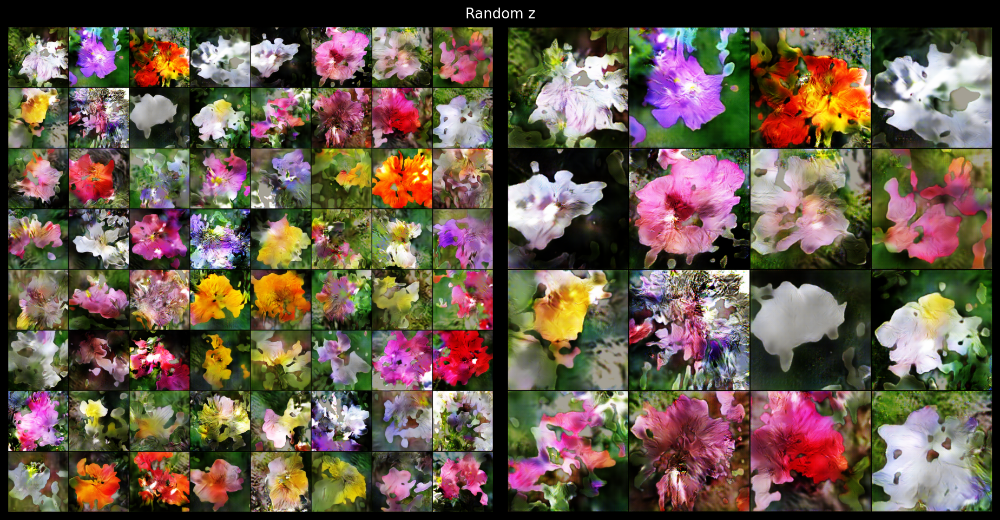

In [ ]:
z = torch.randn(batch_size, nz, 1, 1).to(device)
imgs = netG.net(z).detach().cpu()

fig = plt.figure(figsize=(13,7))

ax = fig.add_subplot(1, 2, 1)
ax.imshow(make_grid(denormalize(imgs),nrow=8,padding=3).permute(1,2,0).squeeze(-1).numpy())
ax.set_axis_off()

ax = fig.add_subplot(1, 2, 2)
ax.imshow(make_grid(denormalize(imgs[:16]),nrow=4,padding=2).permute(1,2,0).numpy())
ax.set_axis_off()

fig.suptitle("Random z")

plt.tight_layout()
plt.show()

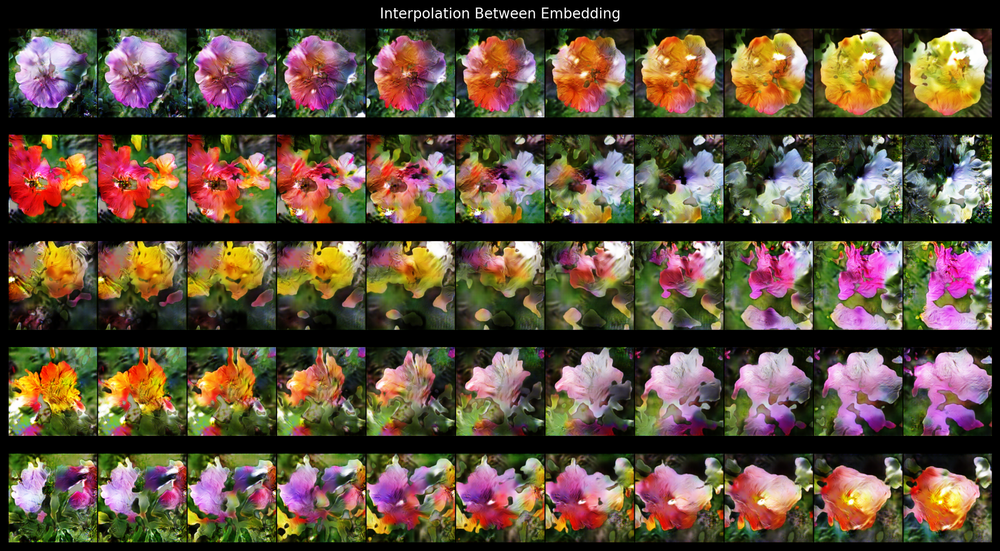

In [ ]:
fig, ax = plt.subplots(5, 1, figsize=(13,7))

for i in range(len(ax)):
    z1, z2 = x_enc[torch.randint(0,len(dataset),(2,))]
    t = torch.linspace(0,1,11).view(-1,1)
    z = gF.slerp(z1, z2, t).unsqueeze(-1).unsqueeze(-1).to(device)
    imgs = netG.net(z).detach().cpu()
    
    ax[i].imshow(make_grid(denormalize(imgs),nrow=11,padding=3).permute(1,2,0).numpy())
    ax[i].set_axis_off()

fig.suptitle("Interpolation Between Embedding",y=1.01)
plt.tight_layout()
plt.show()

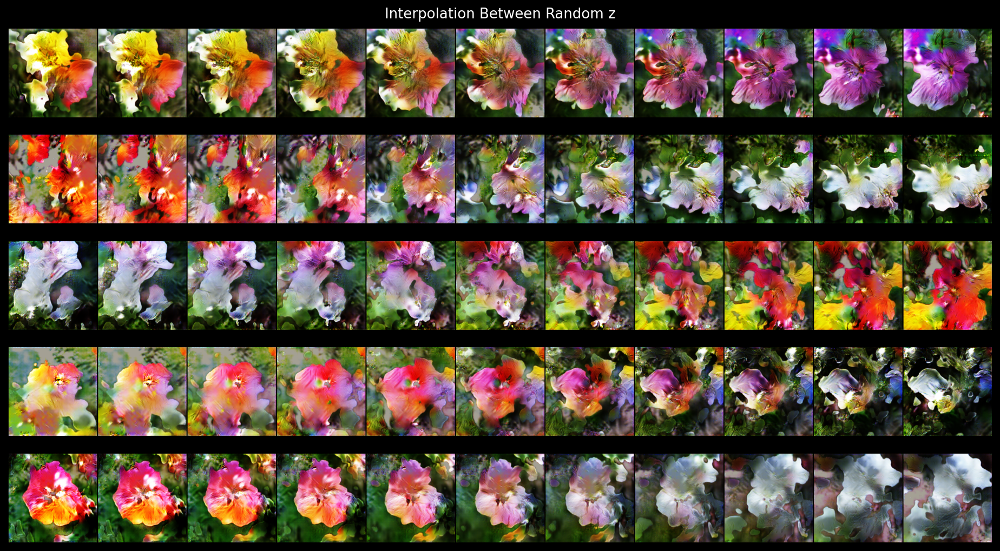

In [ ]:
fig, ax = plt.subplots(5, 1, figsize=(13,7))

for i in range(len(ax)):
    z1, z2 = torch.randn(2, nz)
    t = torch.linspace(0,1,11).view(-1,1)
    z = gF.slerp(z1, z2, t).unsqueeze(-1).unsqueeze(-1).to(device)
    imgs = netG.net(z).detach().cpu()
    
    ax[i].imshow(make_grid(denormalize(imgs),nrow=11,padding=3).permute(1,2,0).numpy())
    ax[i].set_axis_off()

fig.suptitle("Interpolation Between Random z", y=1.01)
plt.tight_layout()
plt.show()

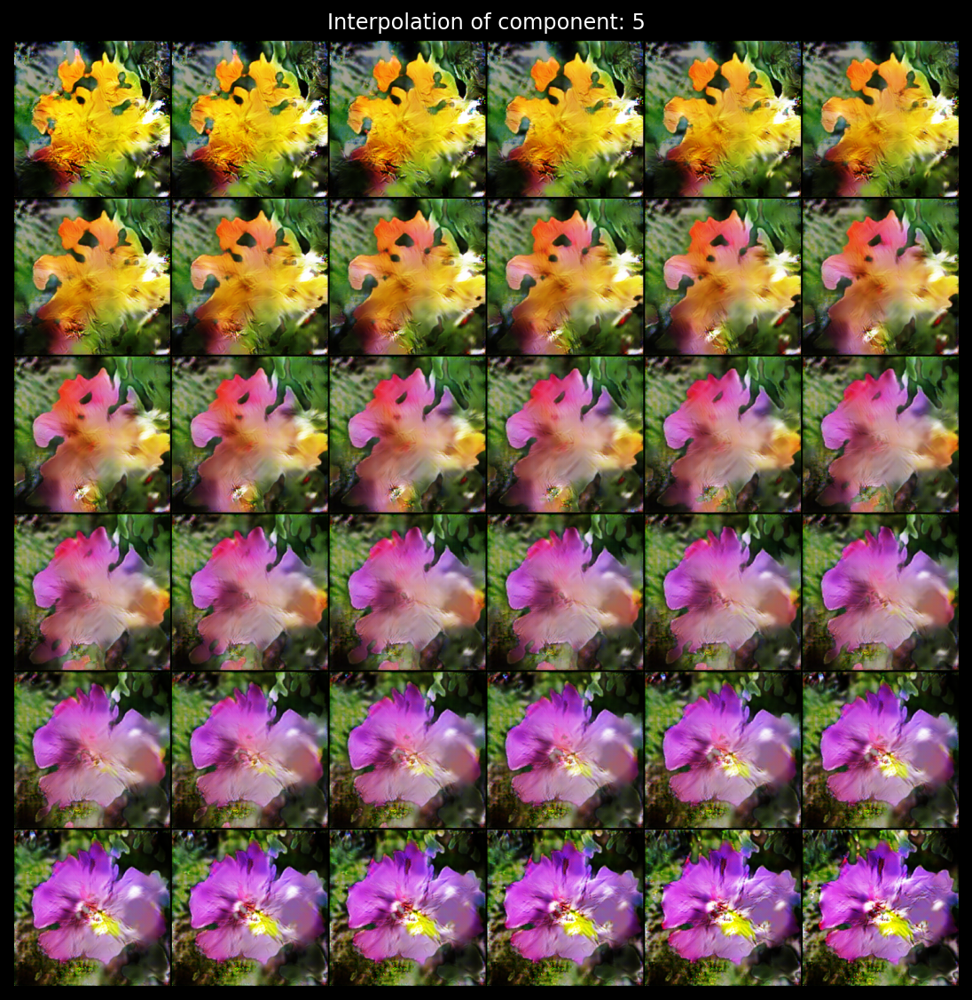

In [ ]:
n, comp = 36, 5
z = np.random.randn(1, nz).repeat(n,0).astype(np.float32)
z[:,comp] = np.linspace(-8,8,n)
z = torch.from_numpy(z).view(n,nz,1,1).to(device)

imgs = netG.net(z).detach().cpu()

plt.figure(figsize=(8,8))
plt.imshow(make_grid(denormalize(imgs),nrow=6,padding=3).permute(1,2,0).squeeze(-1).numpy())
plt.axis('off')
plt.title("Interpolation of component: {}".format(comp))

plt.tight_layout()
plt.show()

## Export

In [ ]:
emb = x_enc.numpy()
quantizer = RangeQuantizer(emb.min(), emb.max())
emb_q = quantizer.quantize(emb)

emb_data = {"shape": emb_q.shape,
            "alpha": emb.min().item(),
            "beta": emb.max().item(),
            "data": emb_q.tobytes()}

layers = []

for name, mod in netG.net.named_modules():
    if not name or isinstance(mod, nn.ReLU) or isinstance(mod, nn.Tanh):
        continue
    if isinstance(mod, nn.ConvTranspose2d):
        w = mod.weight.data.detach().cpu().numpy()
        b = mod.bias.data.detach().cpu().numpy()
        layers.append({"type": "conv_transpose2d",
                        "params":{
                            "weight": {"data": w.tobytes(), "shape": w.shape},
                            "bias": {"data": b.tobytes(), "shape": b.shape}}})
    elif isinstance(mod, nn.BatchNorm2d):
        mu = mod.running_mean.data.detach().cpu().numpy()
        sigma = mod.running_var.data.detach().cpu().numpy()
        w = mod.weight.data.detach().cpu().numpy()
        b = mod.bias.data.detach().cpu().numpy()

        layers.append({"type": "batch_norm2d",
                        "params": {
                            "mu": {"data": mu.tobytes(), "shape": mu.shape},
                            "sigma": {"data": sigma.tobytes(), "shape": sigma.shape},
                            "weight": {"data": w.tobytes(), "shape": w.shape},
                            "bias": {"data": b.tobytes(), "shape": b.shape}}})

In [ ]:
packed = msgpack.packb({"layers": layers, "embedding": emb_data})
with open("{}/g_emb_{}.msgpack".format(save_path, 1399), "wb") as f:
    f.write(packed)